<a href="https://colab.research.google.com/github/valsson-group/UNT-Chem3520/blob/main/Python/ExcitedStates_H2O.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Excited State from TD-DFT

Simple Juypter notebook that performs TD-DFT (Time-dependent density-functional theory) using pyscf.

Part of the code take from and inspired by https://www.andersle.no/posts/2022/mo/mo.html

## Setup python environment and imports

In [1]:
%%capture
!pip install numpy
!pip install scipy
!pip install Cython
!pip install pandas
!pip install sklearn
!pip install statsmodels
!pip install matplotlib
!pip install rdkit
!pip install py3Dmol
!pip install ipywidgets
!pip install sphinx
!pip install nbsphinx
!pip install pydata-sphinx-theme
!pip install lxml
!pip install fortecubeview
!pip install pythreejs
!pip install scikit-image
!pip install pyscf
!pip install shap
!pip install catboost
!pip install graphviz

In [2]:
import pathlib

# RDKit imports:
from rdkit import Chem
from rdkit.Chem import (
    AllChem,
    rdCoordGen,
)
from rdkit.Chem.Draw import IPythonConsole

IPythonConsole.ipython_useSVG = True  # Use higher quality images for molecules

# For visualization of molecules and orbitals:
import py3Dmol
import fortecubeview

# pyscf imports:
from pyscf import gto, scf, dft, tddft, tools

from pyscf.data.nist import HARTREE2EV
from pyscf.data.nist import HARTREE2WAVENUMBER

# For plotting
import matplotlib
from matplotlib import pyplot as plt

%matplotlib inline

# For numerics:
import numpy as np

from google.colab import output
output.enable_custom_widget_manager()

## Function Definitions

In [3]:
def get_xyz(molecule, optimize=False):
    """Get xyz-coordinates for the molecule"""
    mol = Chem.Mol(molecule)
    mol = AllChem.AddHs(mol, addCoords=True)
    AllChem.EmbedMolecule(mol)
    if optimize:  # Optimize the molecules with the MM force field:
        AllChem.MMFFOptimizeMolecule(mol)
    xyz = []
    for lines in Chem.MolToXYZBlock(mol).split("\n")[2:]:
        strip = lines.strip()
        if strip:
            xyz.append(strip)
    xyz = "\n".join(xyz)
    return mol, xyz

In [4]:
def run_calculation_tddft(xyz, functional="b3lyp", basis="sto-3g", nstates=5,symmetry=False):
    """Calculate the energy (+ additional things like MO coefficients) with pyscf."""
    mol = gto.M(
        atom=xyz,
        basis=basis,
        unit="ANG",
        symmetry=symmetry,
    )
    mol.build()
    mf = dft.RKS(mol)
    mf.xc = functional
    mf.kernel()
    td = tddft.TDDFT(mf)
    td.nstates = nstates
    td.kernel()
    return mf, mol, td

In [5]:
def write_cube_files(
    max_homo_lumo=5, prefix="", dirname=".", margin=5, write_all_orbitals=False
):
    """Write cube files for the given coefficients."""
    path = pathlib.Path(dirname)
    path.mkdir(parents=True, exist_ok=True)

    # find index of HOMO and LUMO
    lumo = float("inf")
    lumo_idx = None
    homo = -float("inf")
    homo_idx = None
    for i, (energy, occ) in enumerate(zip(mf.mo_energy, mf.mo_occ)):
        if occ > 0 and energy > homo:
            homo = energy
            homo_idx = i
        if occ == 0 and energy < lumo:
            lumo = energy
            lumo_idx = i

    if(write_all_orbitals):
      for i in range(mf.mo_coeff.shape[1]):
        outfile = f"{prefix}Orbital-{i:02d}.cube"
        outfile = path / outfile
        print(f"Writing {outfile}")
        tools.cubegen.orbital(mol, outfile, mf.mo_coeff[:, i], margin=margin)
    else:
      print(f"HOMO (index): {homo_idx+1}")
      print(f"LUMO (index): {lumo_idx+1}")
      print("")
      outfile = f"{prefix}HOMO.cube"
      outfile = path / outfile
      print(f"Writing {outfile}")
      tools.cubegen.orbital(mol, outfile, mf.mo_coeff[:, homo_idx], margin=margin)

      outfile = f"{prefix}LUMO.cube"
      outfile = path / outfile
      print(f"Writing {outfile}")
      tools.cubegen.orbital(mol, outfile, mf.mo_coeff[:, lumo_idx], margin=margin)

      for i in range(1,max_homo_lumo+1):
        outfile = f"{prefix}HOMO_minus-{i:02d}.cube"
        outfile = path / outfile
        print(f"Writing {outfile}")
        tools.cubegen.orbital(mol, outfile, mf.mo_coeff[:, homo_idx-i], margin=margin)

        outfile = f"{prefix}LUMO_plus-{i:02d}.cube"
        outfile = path / outfile
        print(f"Writing {outfile}")
        tools.cubegen.orbital(mol, outfile, mf.mo_coeff[:, lumo_idx+i], margin=margin)

In [6]:
def GaussianPeak(x,mean,sigma):
  return np.exp(-(x-mean)**2/(2*sigma**2))

def plot_spectrum_eV(exc,osc,width=0.2,x_range=None):
  if x_range is None:
    x_min = round(exc[0]-4*width)
    x_max = round(exc[-1]+4*width+0.5)
  else:
    x_min = x_range[0]
    x_max = x_range[1]
  x=np.linspace(x_min,x_max,1000)
  y=np.zeros(x.size)
  for i, e in enumerate(exc):
    if not np.isnan(osc[i]):
      y+=osc[i]*GaussianPeak(x,e,width)

  plt.plot(x,y)
  plt.xlabel("Excitation [eV]")
  plt.ylabel("Intensity")
  plt.xlim([x_min,x_max])
  for i, e in enumerate(exc):
    if not np.isnan(osc[i]):
      plt.stem(e,osc[i],linefmt="--")
  plt.show()

def plot_spectrum_nm(exc,osc,width=10,x_range=None):
  if x_range is None:
    x_min = round(exc[-1]-4*width+0.5)
    x_max = round(exc[0]+4*width)
  else:
    x_min = x_range[0]
    x_max = x_range[1]
  x=np.linspace(x_min,x_max,1000)
  y=np.zeros(x.size)
  for i, e in enumerate(exc):
    if not np.isnan(osc[i]):
      y+=osc[i]*GaussianPeak(x,e,width)

  plt.plot(x,y)
  plt.xlabel("Wavelength [nm]")
  plt.ylabel("Intensity")
  plt.xlim([x_min,x_max])
  for i, e in enumerate(exc):
    if not np.isnan(osc[i]):
      plt.stem(e,osc[i],linefmt="--")
  plt.show()


## Definition of Molecule from SMILES String

**Here you should define the smiles string for the molecule you want to consider**




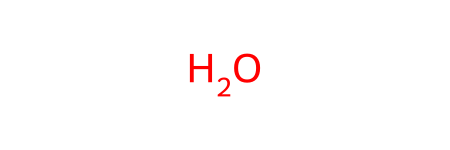

In [7]:
molecule_smiles = "O" #@param {type:"string"}

molecule_name = "Mol"
molecule = Chem.MolFromSmiles(molecule_smiles)  # Generate the molecule from smiles
molecule

## Setup of Molecule

In [8]:
molecule3d, xyz = get_xyz(molecule, optimize=True)
print(xyz)

O      0.007544    0.397743    0.000000
H     -0.767103   -0.184393    0.000000
H      0.759559   -0.213350    0.000000


In [9]:
view = py3Dmol.view(
    data=Chem.MolToMolBlock(molecule3d),
    style={"stick": {}, "sphere": {"scale": 0.3}},
    width=300,
    height=300,
  )
view.zoomTo()

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

## DFT and TD-DFT Calculations

In [10]:
mf, mol, td = run_calculation_tddft(xyz, basis="cc-pVDZ",nstates=10,symmetry=True)

/usr/local/lib/python3.10/dist-packages/pyscf/dft/libxc.py:1102: UserWarning: Since PySCF-2.3, B3LYP (and B3P86) are changed to the VWN-RPA variant, corresponding to the original definition by Stephens et al. (issue 1480) and the same as the B3LYP functional in Gaussian. To restore the VWN5 definition, you can put the setting "B3LYP_WITH_VWN5 = True" in pyscf_conf.py
  warnings.warn('Since PySCF-2.3, B3LYP (and B3P86) are changed to the VWN-RPA variant, '


converged SCF energy = -76.4205866498328
Excited State energies (eV)
[ 7.51162768  9.36586152  9.88534772 11.84065291 13.8345082  16.74899486
 20.60549674 22.368539   23.80160217 24.59435985]


## Analysis of Results

### DFT Results



In [11]:
mf.analyze(verbose=3)

Wave-function symmetry = A1
occupancy for each irrep:     A1   A2   B1   B2
                               3    0    1    1
**** MO energy ****
MO #1 (A1 #1), energy= -19.1241273074635 occ= 2
MO #2 (A1 #2), energy= -0.990755672407666 occ= 2
MO #3 (B2 #1), energy= -0.508865099734218 occ= 2
MO #4 (A1 #3), energy= -0.364898066025352 occ= 2
MO #5 (B1 #1), energy= -0.287339063522298 occ= 2
MO #6 (A1 #4), energy= 0.0493861219439642 occ= 0
MO #7 (B2 #2), energy= 0.125132429713236 occ= 0
MO #8 (B2 #3), energy= 0.552858335906523 occ= 0
MO #9 (A1 #5), energy= 0.606834753342836 occ= 0
MO #10 (A1 #6), energy= 0.90222642193206 occ= 0
MO #11 (B1 #2), energy= 0.918413173715939 occ= 0
MO #12 (B2 #4), energy= 0.995309171090513 occ= 0
MO #13 (A1 #7), energy= 1.20170718925204 occ= 0
MO #14 (A2 #1), energy= 1.23241344479893 occ= 0
MO #15 (B1 #3), energy= 1.42310204424763 occ= 0
MO #16 (A1 #8), energy= 1.59372639181233 occ= 0
MO #17 (B2 #5), energy= 1.66258870093063 occ= 0
MO #18 (B2 #6), energy= 2.0914551

((array([1.99995715e+00, 1.65556877e+00, 3.64285155e-03, 1.29788812e+00,
         1.64254467e+00, 1.99176621e+00, 9.04199114e-03, 1.33375660e-03,
         2.22812107e-03, 4.25062590e-03, 1.27992894e-03, 2.43621236e-03,
         4.60499064e-07, 7.61988576e-04, 6.77705929e-01, 1.08686680e-02,
         1.31790166e-03, 1.39448737e-03, 2.36263834e-03, 6.77705825e-01,
         1.08686678e-02, 1.29883216e-03, 1.41355659e-03, 2.36263817e-03]),
  array([-0.61270086,  0.30635038,  0.30635048])),
 array([-3.64427648e-02, -1.92138071e+00, -2.49537624e-16]))

### TD-DFT Results

In [12]:
td.analyze(verbose=4)


** Singlet excitation energies and oscillator strengths **
Excited State   1:  ???      7.51163 eV    165.06 nm  f=0.0222
       5 -> 6         0.70710
Excited State   2:  ???      9.36586 eV    132.38 nm  f=0.0000
       5 -> 7         0.70634
Excited State   3:  ???      9.88535 eV    125.42 nm  f=0.0816
       4 -> 6        -0.70357
Excited State   4:  ???     11.84065 eV    104.71 nm  f=0.0577
       4 -> 7         0.70268
Excited State   5:  ???     13.83451 eV     89.62 nm  f=0.2889
       3 -> 6         0.70265
Excited State   6:  ???     16.74899 eV     74.02 nm  f=0.1236
       3 -> 7         0.69485
Excited State   7:   A2     20.60550 eV     60.17 nm  f=0.0000
       5 -> 8         0.70644
Excited State   8:   B1     22.36854 eV     55.43 nm  f=0.0634
       5 -> 9        -0.70503
Excited State   9:  ???     23.80160 eV     52.09 nm  f=0.1200
       3 -> 9        -0.14882
       4 -> 8         0.68705
Excited State  10:  ???     24.59436 eV     50.41 nm  f=0.0032
       2 -

## Plot Spectrum

Here we plot the spectra by taking each excitation as a Gaussian peak with a finite width that represent broading effects. Each Gaussian peak is weighted with the oscillator strength.

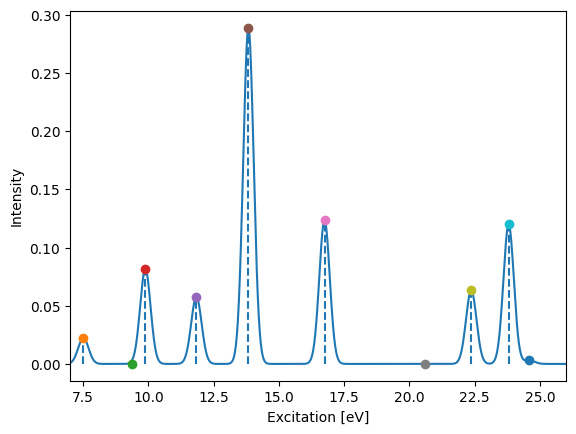

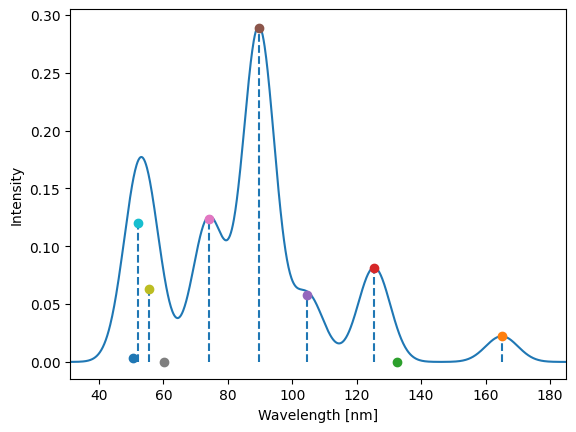

In [16]:
exc_eV=td.e*HARTREE2EV
osc=td.oscillator_strength()
exc_nm=1e7/(td.e*HARTREE2WAVENUMBER)

# print(exc_eV)
# print(exc_nm)

# Peak width in eV
peak_width_eV=0.2
peak_width_nm=5

plot_spectrum_eV(exc_eV,osc,width=peak_width_eV)
plot_spectrum_nm(exc_nm,osc,width=peak_width_nm)


## Setup Orbitals

In [19]:
!rm -rf cube_files
write_cube_files(
   dirname="cube_files",
   write_all_orbitals=False,
   max_homo_lumo=2
)

HOMO (index): 5
LUMO (index): 6

Writing cube_files/HOMO.cube
Writing cube_files/LUMO.cube
Writing cube_files/HOMO_minus-01.cube
Writing cube_files/LUMO_plus-01.cube
Writing cube_files/HOMO_minus-02.cube
Writing cube_files/LUMO_plus-02.cube


## Visualize Orbitals

In [20]:
fortecubeview.plot(path="./cube_files/", width=600, height=300, colorscheme='national', sumlevel=0.7)

CubeViewer: listing cube files from the directory ./cube_files/
Reading 6 cube files


HTML(value='\n        <style>\n           .jupyter-widgets-output-area .output_scroll {\n                heigh…

interactive(children=(Select(description='Cube files:', options=('./cube_files/HOMO.cube', './cube_files/HOMO_…

TraitError: The 'target' trait of a DirectionalLight instance expected an Uninitialized or an Object3D, not the str 'IPY_MODEL_d6294a9e-863b-4cd8-a3af-8091a471fc31'.